<a href="https://colab.research.google.com/github/Fzaplana/Green-Start/blob/master/Hpsp_5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install geocoder

     |████████████████████████████████| 102kB 3.5MB/s 


In [2]:
!pip install mplleaflet

  Created wheel for mplleaflet: filename=mplleaflet-0.0.5-cp36-none-any.whl size=28556 sha256=d5d7b13a061eb02c60ff28bf456f30de275cffe8e366028d651a86f8984bb1da
  Stored in directory: /root/.cache/pip/wheels/bf/fd/0b/0513de62c339c4a56e2234aa42a5d06e6660a4446fdae7b796
Successfully built mplleaflet


In [3]:
!pip install geopandas

     |████████████████████████████████| 931kB 4.4MB/s 
     |████████████████████████████████| 10.9MB 15.5MB/s 
     |████████████████████████████████| 14.7MB 315kB/s 


In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [5]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [6]:
import os
#os.chdir('/Users/franciscozaplana/Downloads/TESIS')
os.chdir('/content/drive/My Drive/Download/TESIS/')
os.getcwd()

'/content/drive/My Drive/Download/TESIS'

In [7]:
pd.set_option('display.max_columns',50)
pd.get_option("display.max_columns")

50

In [0]:
sns.set(style="white")
sns.set(style="whitegrid", color_codes=True)

# Import Datasets:

Importamos el Dataset extraido de OpenData de Barcelona de los Hospitales y Centros de primera atención.

Solo importamos las columnas mas relevantes para nuestro analisis, las hemos seleccionado previamente.

In [0]:
Hosp = pd.read_csv('S0002_Hospitals_I_dAtencio_Primaria.csv', usecols=[0,1,2,3,4,5,6,7,8,9,10,11,14,15,16,17,18,19])

In [10]:
# revisamos la cantidad de Columnas cargadas
Hosp.columns.value_counts().sum()

18

In [11]:
Hosp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 399 entries, 0 to 398
Data columns (total 18 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   CODI_EQUIPAMENT  399 non-null    int64  
 1   EQUIPAMENT       399 non-null    object 
 2   SECCIO           399 non-null    object 
 3   TIPUS_VIA        399 non-null    object 
 4   NOM_CARRER       399 non-null    object 
 5   NUM_CARRER_1     399 non-null    int64  
 6   NUM_CARRER_2     396 non-null    float64
 7   CODI_BARRI       399 non-null    int64  
 8   NUM_BARRI        399 non-null    object 
 9   CODI_DISTRICTE   399 non-null    int64  
 10  NOM_DISTRICTE    399 non-null    object 
 11  CODI_POSTAL      399 non-null    int64  
 12  LATITUD          399 non-null    float64
 13  LONGITUD         399 non-null    float64
 14  X_ETRS89         399 non-null    float64
 15  Y_ETRS89         399 non-null    float64
 16  X_ED50           399 non-null    float64
 17  Y_ED50          

Revisamos la cantidad de Columnas con información nula

In [12]:
Hosp.isnull().sum()

CODI_EQUIPAMENT    0
EQUIPAMENT         0
SECCIO             0
TIPUS_VIA          0
NOM_CARRER         0
NUM_CARRER_1       0
NUM_CARRER_2       3
CODI_BARRI         0
NUM_BARRI          0
CODI_DISTRICTE     0
NOM_DISTRICTE      0
CODI_POSTAL        0
LATITUD            0
LONGITUD           0
X_ETRS89           0
Y_ETRS89           0
X_ED50             0
Y_ED50             0
dtype: int64

## "EQUIPAMENT "
La información relevante se encuentra dentro de la Columna "EQUIPAMENT " que es la que contiene los nombres de los Centros de Atención, por lo que haremos una revisión de cuantas veces se repiten

In [13]:
Hosp['EQUIPAMENT'].value_counts()

Centre d'Atenció Primària Doctor Lluís Sayé                        8
Hospital del Mar                                                   8
Centre d'Atenció Primària Numància                                 8
Hospital de la Santa Creu i Sant Pau                               8
Centre d'Atenció Primària Passeig Maragall                         8
                                                                  ..
Hospital de Dia per Adolescents en Salut Mental                    1
Hospital Universitari Quirón Dexeus                                1
Clínica Oftalmològica Visioncore                                   1
Cliníca Axisclínic *Comte d'Urgell                                 1
Hospital de Dia d'Adolescents Les Corts - Sarrià - Sant Gervasi    1
Name: EQUIPAMENT, Length: 125, dtype: int64

In [14]:
# Revisamos cuantos Valores unicos tenemos dentro de la columna 'EQUIPAMENT'
Hosp['EQUIPAMENT'].nunique()

125

In [15]:
Hosp['EQUIPAMENT'].unique()

array(['Instituto Oftalmológico Tres Torres',
       'Hospital de dia - Numància', "Centre d'Atenció Primària Roquetes",
       "Centre d'Atenció Primària Gòtic",
       "Centre d'Atenció Primària Sardenya",
       "Centre d'Atenció Primària Besòs", 'Hospital del Mar',
       "Centre d'Atenció Primària Les Hortes",
       'Hospital Universitari Quirón Dexeus', 'Clínica Corachan',
       'Hospital de Nens de Barcelona', 'Clínica Mi Tres Torres',
       'Institut Català de Retina - Sarrià', 'Clínica Sant Jordi',
       'Clínica Serveis Clinics S.A.U', 'Hospital de Barcelona',
       'Hospital Delfos', 'Clínica Planas', 'CBC Clínica Barceloneta',
       'Residència Sociosanitaria Assistida Psicoclínica Mare de Déu de la Mercè',
       'Hospital Sant Rafael', 'Clínica Centro Médico Aragón',
       'Clínica Coroleu', 'Clínica Sagrada Família',
       'Fundació Privada en Salut Mental CPB. Doctor Fàbregas',
       'Centre Hospitalari Copèrnic', 'Clínica Nostra Senyora del Remei',
       'Pol

In [16]:
Hosp_Group=Hosp.groupby('EQUIPAMENT')
Hosp_Group

In [17]:
print ('\x1b[1;33m'"Number of duplicated rows:"'\x1b[0m', Hosp['EQUIPAMENT'].duplicated().sum())

Number of duplicated rows: 274


# Cleaning

Al ser nuestra variable principal el nombre del Centro de Salud, realizamos la limpueza de la Data (Duplicados) sobre esta Columna.

In [0]:
Hosp_clean=Hosp.drop_duplicates('EQUIPAMENT')

In [19]:
Hosp_clean.nunique()

CODI_EQUIPAMENT    125
EQUIPAMENT         125
SECCIO              10
TIPUS_VIA            7
NOM_CARRER         106
NUM_CARRER_1        79
NUM_CARRER_2        82
CODI_BARRI          53
NUM_BARRI           53
CODI_DISTRICTE      10
NOM_DISTRICTE       10
CODI_POSTAL         37
LATITUD            120
LONGITUD           120
X_ETRS89           121
Y_ETRS89           121
X_ED50             121
Y_ED50             121
dtype: int64

Podemos apreciar que se tienen Centros de Atencion medica solo en 53 barrios

In [20]:
Hosp_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 125 entries, 0 to 397
Data columns (total 18 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   CODI_EQUIPAMENT  125 non-null    int64  
 1   EQUIPAMENT       125 non-null    object 
 2   SECCIO           125 non-null    object 
 3   TIPUS_VIA        125 non-null    object 
 4   NOM_CARRER       125 non-null    object 
 5   NUM_CARRER_1     125 non-null    int64  
 6   NUM_CARRER_2     124 non-null    float64
 7   CODI_BARRI       125 non-null    int64  
 8   NUM_BARRI        125 non-null    object 
 9   CODI_DISTRICTE   125 non-null    int64  
 10  NOM_DISTRICTE    125 non-null    object 
 11  CODI_POSTAL      125 non-null    int64  
 12  LATITUD          125 non-null    float64
 13  LONGITUD         125 non-null    float64
 14  X_ETRS89         125 non-null    float64
 15  Y_ETRS89         125 non-null    float64
 16  X_ED50           125 non-null    float64
 17  Y_ED50          

In [21]:
#Hosp_clean['EQUIPAMENT'].value_counts()==1
# nos dice si algun nos quedó algun centro de salud que tenga más de dos valores dentro de la Columna
[i for i, x in enumerate(Hosp_clean['EQUIPAMENT'].value_counts()!=1) if x]

[]

In [22]:
Hosp_clean.shape

(125, 18)

In [23]:
Hosp_clean[Hosp_clean['CODI_BARRI']==3]

,CODI_EQUIPAMENT,EQUIPAMENT,SECCIO,TIPUS_VIA,NOM_CARRER,NUM_CARRER_1,NUM_CARRER_2,CODI_BARRI,NUM_BARRI,CODI_DISTRICTE,NOM_DISTRICTE,CODI_POSTAL,LATITUD,LONGITUD,X_ETRS89,Y_ETRS89,X_ED50,Y_ED50
23,1354152528,Hospital del Mar,Servei d'Urgències Psiquiàtriques,Pg,Marítim de la Barceloneta,23,31.0,3,la Barceloneta,1,Ciutat Vella,8003,41.383433,2.194692,432666.062,4581636.036,432758.015,4581836.967
51,75990099869,CBC Clínica Barceloneta,#,C,Pescadors,88,88.0,3,la Barceloneta,1,Ciutat Vella,8003,41.375937,2.189997,432265.738,4580807.448,432357.688,4581008.372
253,93131085357,Centre d'Atenció Primària Barceloneta,#,Pg,Marítim de la Barceloneta,25,25.0,3,la Barceloneta,1,Ciutat Vella,8003,41.383433,2.194692,432666.062,4581636.036,432758.015,4581836.967


In [24]:
Hosp_clean.head()

,CODI_EQUIPAMENT,EQUIPAMENT,SECCIO,TIPUS_VIA,NOM_CARRER,NUM_CARRER_1,NUM_CARRER_2,CODI_BARRI,NUM_BARRI,CODI_DISTRICTE,NOM_DISTRICTE,CODI_POSTAL,LATITUD,LONGITUD,X_ETRS89,Y_ETRS89,X_ED50,Y_ED50
0,68125439,Instituto Oftalmológico Tres Torres,#,Via,Augusta,281,285.0,24,les Tres Torres,5,Sarrià-Sant Gervasi,8017,41.397669,2.129943,427268.090,4583268.854,427359.993,4583469.799
2,179151955,Hospital de dia - Numància,#,C,Numància,9,13.0,18,Sants,3,Sants-Montjuïc,8029,41.381424,2.141052,428178.827,4581456.048,428270.739,4581656.976
4,334115716,Centre d'Atenció Primària Roquetes,#,C,Garigliano,23,27.0,50,les Roquetes,8,Nou Barris,8042,41.446174,2.173934,430996.884,4588617.760,431088.820,4588818.755
10,349141404,Centre d'Atenció Primària Gòtic,#,Ptge,Pau,1,1.0,2,el Barri Gòtic,1,Ciutat Vella,8002,41.378814,2.177034,431184.791,4581137.116,431276.731,4581338.042
13,1015170605,Centre d'Atenció Primària Sardenya,#,C,Sardenya,466,466.0,33,el Baix Guinardó,7,Horta-Guinardó,8025,41.409468,2.165567,430258.706,4584549.468,430350.636,4584750.426


In [0]:
Hosp_clean.to_csv('/content/drive/My Drive/Download/TESIS/Output/Hosp_clean.csv')

## Analisis

Realizamos un analisis de los Barrios con más Hosp

In [0]:
sns.set(rc={'figure.figsize':(20,8.27)})

Text(0.5, 1.0, 'Hospitales por Barrio')

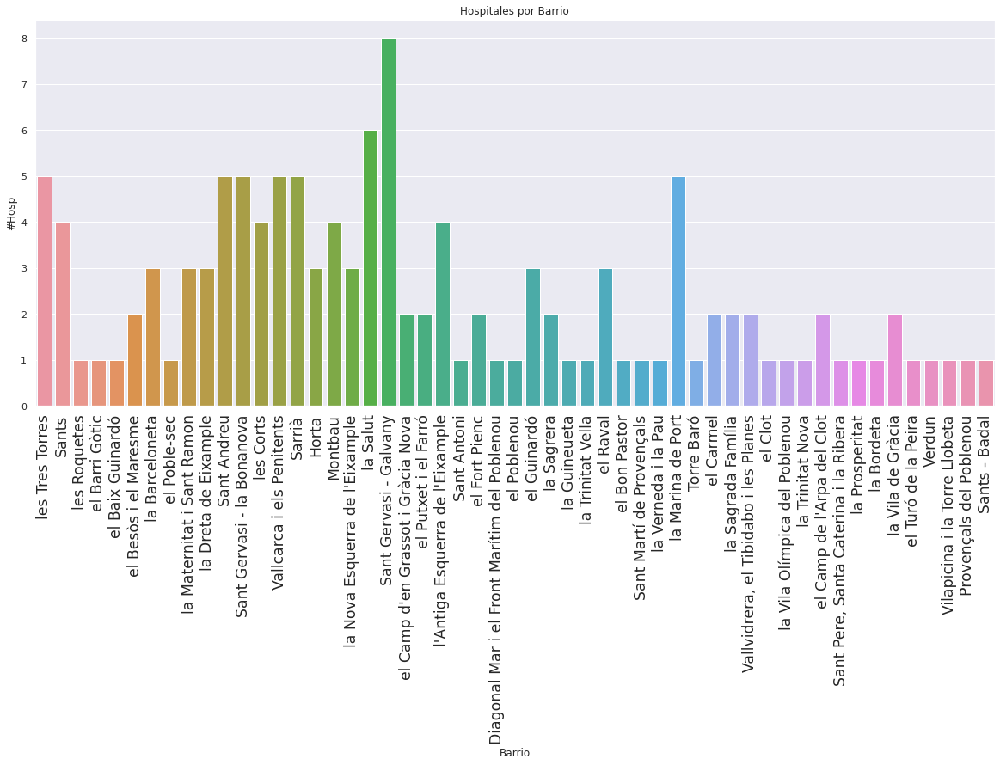

In [27]:
#cantidad de Hospitales por Barrio
ax=sns.countplot('NUM_BARRI',data=Hosp_clean)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90,fontsize='x-large' )
ax.set_ylabel('#Hosp')
ax.set_xlabel('Barrio')
ax.set_title('Hospitales por Barrio')



In [0]:
#data = Hosp.groupby('NUM_BARRI').filter(lambda x : len(x)>1).groupby('NUM_BARRI').size()
#data

Text(0.5, 1.0, 'Top 10 Hospitales por Barrio')

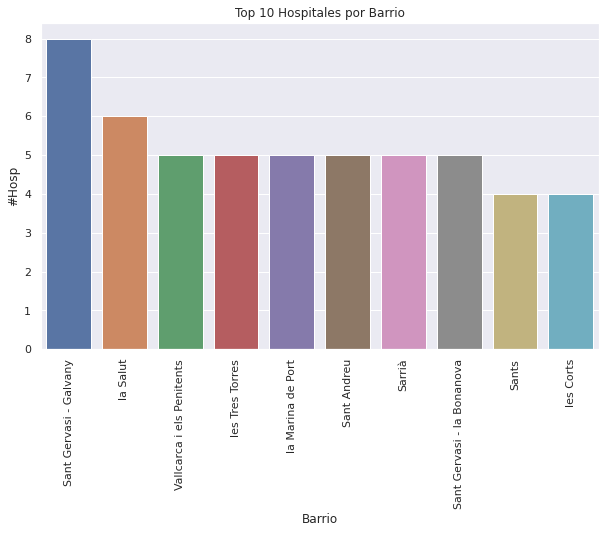

In [29]:
sns.set(rc={'figure.figsize':(10,6)}) # seteamos el tamaño del grafico
ax=Hosp_clean.NUM_BARRI.value_counts().head(10).index
ay=Hosp_clean.NUM_BARRI.value_counts().head(10)
ax=sns.barplot(x=ax,y=ay)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90 )
ax.set_ylabel('#Hosp')
ax.set_xlabel('Barrio')
ax.set_title('Top 10 Hospitales por Barrio')


In [30]:
import folium
from folium.plugins import HeatMap,Fullscreen

#creo mapa de fondo - situado en Barcelona y un Zoom de 12
barcelona_map2 = folium.Map(location=[41.38879, 2.15899], zoom_start=12.5)

# definimos el dataframe para el Heat Mat con lat y long
heat_df=Hosp_clean[['LATITUD','LONGITUD']]

heat_data=[[row['LATITUD'],row['LONGITUD']] for index,row in heat_df.iterrows()]

#agrego el mapa de calor al mapa base
HeatMap(heat_data).add_to(barcelona_map2)

#agrego funcionalidad para poder ponerlo en full screen
Fullscreen(
    position='topright',
    title='Expand me',
    title_cancel='Exit me',
    force_separate_button=True
).add_to(barcelona_map2)

print('_'*50+ '\x1b[1;33m'"MAPA DE CALOR "'\x1b[0m' + '_'*50)
print ()
barcelona_map2

__________________________________________________MAPA DE CALOR __________________________________________________



In [0]:
import folium
import geocoder   #  geocoder with ArcGIS  <- NOT AVAILABLE ON KAGGLE
from   folium.plugins import MarkerCluster
import geopandas as gpd
import json
import branca.colormap as cm


barce = gpd.read_file('barris.geojson')
geo_json_data = json.load(open('barris.geojson'))

In [32]:
map = folium.Map(location=[41.414206, 2.174385], 
                 #tiles='Stamen Toner',
                 zoom_start=13)
heat_df=Hosp_clean[['LATITUD','LONGITUD']]

heat_data=[[row['LATITUD'],row['LONGITUD']] for index,row in heat_df.iterrows() ]

#agrego el mapa de calor al mapa base
HeatMap(heat_data).add_to(map)

'''
for _,row in Hosp_clean.iterrows():
    lat = row['LATITUD']
    lon = row['LONGITUD']
    name = row['EQUIPAMENT']
    newMarker = folium.Marker([lat,lon], popup=name,
    icon=folium.Icon(color='blue',
                        #icon_color='gray',
                        prefix='fa', 
                        icon='medkit',
                        angle=45)
    )
    newMarker.add_to(map)
'''    
folium.GeoJson(barce, name="geojson").add_to(map)
map

In [33]:
Hosp_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 125 entries, 0 to 397
Data columns (total 18 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   CODI_EQUIPAMENT  125 non-null    int64  
 1   EQUIPAMENT       125 non-null    object 
 2   SECCIO           125 non-null    object 
 3   TIPUS_VIA        125 non-null    object 
 4   NOM_CARRER       125 non-null    object 
 5   NUM_CARRER_1     125 non-null    int64  
 6   NUM_CARRER_2     124 non-null    float64
 7   CODI_BARRI       125 non-null    int64  
 8   NUM_BARRI        125 non-null    object 
 9   CODI_DISTRICTE   125 non-null    int64  
 10  NOM_DISTRICTE    125 non-null    object 
 11  CODI_POSTAL      125 non-null    int64  
 12  LATITUD          125 non-null    float64
 13  LONGITUD         125 non-null    float64
 14  X_ETRS89         125 non-null    float64
 15  Y_ETRS89         125 non-null    float64
 16  X_ED50           125 non-null    float64
 17  Y_ED50          

In [34]:
'''
# add labels indicating the name of the community
style_function = "font-size: 15px; font-weight: bold"
choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['name'], style=style_function, labels=False))
'''

'\n# add labels indicating the name of the community\nstyle_function = "font-size: 15px; font-weight: bold"\nchoropleth.geojson.add_child(\n    folium.features.GeoJsonTooltip([\'name\'], style=style_function, labels=False))\n'

In [35]:
'''
map = folium.Map(location=[41.414206, 2.174385], 
                 #tiles='Stamen Toner',
                 zoom_start=13)
heat_df=Hosp_clean[['LATITUD','LONGITUD']]

heat_data=[[row['LATITUD'],row['LONGITUD']] for index,row in heat_df.iterrows() ]

#agrego el mapa de calor al mapa base
HeatMap(heat_data).add_to(map)

folium.GeoJson(barce, name="geojson").add_to(map)

# add labels indicating the name of the community
style_function = "font-size: 15px; font-weight: bold"


folium.features.GeoJsonTooltip(['name'], style=style_function, labels=False).add_to(map)

map
'''

'\nmap = folium.Map(location=[41.414206, 2.174385], \n                 #tiles=\'Stamen Toner\',\n                 zoom_start=13)\nheat_df=Hosp_clean[[\'LATITUD\',\'LONGITUD\']]\n\nheat_data=[[row[\'LATITUD\'],row[\'LONGITUD\']] for index,row in heat_df.iterrows() ]\n\n#agrego el mapa de calor al mapa base\nHeatMap(heat_data).add_to(map)\n\nfolium.GeoJson(barce, name="geojson").add_to(map)\n\n# add labels indicating the name of the community\nstyle_function = "font-size: 15px; font-weight: bold"\n\n\nfolium.features.GeoJsonTooltip([\'name\'], style=style_function, labels=False).add_to(map)\n\nmap\n'

In [36]:

Hosp_per_ne = pd.DataFrame(Hosp_clean['CODI_BARRI'].value_counts().astype(float))
Hosp_per_ne.to_json('Hosp_per_ne.json')
Hosp_per_ne = Hosp_per_ne.reset_index()
Hosp_per_ne.columns = ['BARRI', 'Number']
Hosp_per_ne


,BARRI,Number
0,26,8.0
1,30,6.0
2,23,5.0
3,28,5.0
4,13,5.0
5,60,5.0
6,25,5.0
7,24,5.0
8,40,4.0
9,8,4.0


In [37]:

Hosp_per = pd.DataFrame(Hosp_clean['NUM_BARRI'].value_counts().astype(float))
Hosp_per.to_json('Hosp_per.json')
Hosp_per = Hosp_per.reset_index()
Hosp_per.columns = ['NUM_BARRI', 'Number']
Hosp_per


,NUM_BARRI,Number
0,Sant Gervasi - Galvany,8.0
1,la Salut,6.0
2,Vallcarca i els Penitents,5.0
3,les Tres Torres,5.0
4,la Marina de Port,5.0
5,Sant Andreu,5.0
6,Sarrià,5.0
7,Sant Gervasi - la Bonanova,5.0
8,Sants,4.0
9,les Corts,4.0


In [0]:
map1 = folium.Map(location=[41.414206, 2.174385], 
                 #tiles='Stamen Toner',
                 zoom_start=13)

In [39]:
'''
# EJEMPLO DE MAPA con choropleth
map1 = folium.Map(location=[41.414206, 2.174385], 
                 #tiles='Stamen Toner',
                 zoom_start=12)
map1.choropleth(geo_data="nyc-zip-codes.geojson",
             data=zipcodes_agg, # my dataset
             columns=['ZIP', 'SALE PRICE'], # zip code is here for matching the geojson zipcode, sales price is the column that changes the color of zipcode areas
             key_on='feature.properties.postalCode', # this path contains zipcodes in str type, this zipcodes should match with our ZIP CODE column
             fill_color='BuPu', fill_opacity=0.7, line_opacity=0.2,
             legend_name='SALE PRICE')
'''


'\n# EJEMPLO DE MAPA con choropleth\nmap1 = folium.Map(location=[41.414206, 2.174385], \n                 #tiles=\'Stamen Toner\',\n                 zoom_start=12)\nmap1.choropleth(geo_data="nyc-zip-codes.geojson",\n             data=zipcodes_agg, # my dataset\n             columns=[\'ZIP\', \'SALE PRICE\'], # zip code is here for matching the geojson zipcode, sales price is the column that changes the color of zipcode areas\n             key_on=\'feature.properties.postalCode\', # this path contains zipcodes in str type, this zipcodes should match with our ZIP CODE column\n             fill_color=\'BuPu\', fill_opacity=0.7, line_opacity=0.2,\n             legend_name=\'SALE PRICE\')\n'

### Para ponerle texto intentar este codigo = 



```
plt.text(x0, y0, id, fontsize=10)

if print_id != False:
            x0 = np.mean(x_lon)
            y0 = np.mean(y_lat)
            plt.text(x0, y0, id, fontsize=10)
```



#Choropleth maps folium

In [40]:
map2 = folium.Map(location=[41.414206, 2.174385], 
                 #tiles='Stamen Toner',
                 zoom_start=12)
map2.choropleth(geo_data=barce,
             data=Hosp_per, # my dataset
             columns=['NUM_BARRI', 'Number'], # 'NUM_BARRI' es el que hace match con el geojson, Number es la columna que hace que cambie de color
             key_on='feature.properties.NOM', # esto es lo que hce Match con NUM_BARRI (se reviso en el geojson)
             fill_color='YlOrBr', # las opciones de colores que tenemos son : ‘BuGn’, ‘BuPu’, ‘GnBu’, ‘OrRd’, ‘PuBu’, ‘PuBuGn’, ‘PuRd’, ‘RdPu’, ‘YlGn’, ‘YlGnBu’, ‘YlOrBr’, and ‘YlOrRd’.
             highlight=True,   # esto hace que cuando se pasa por enciam se encienda esa parte del mapa
             fill_opacity=0.7, 
             line_opacity=0.2,
             legend_name='HOSPITALS PER NEIGHBORHOOD'
             )

map2

/usr/local/lib/python3.6/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [41]:
import folium
from ipywidgets import interact

# Cloudmade Mapbox needs an API key, Mapbox Control Room is limited to a few levels
tiles = [name.strip() for name in """
    OpenStreetMap
    Mapbox Bright
    Mapbox Control Room
    Stamen Toner
    Stamen Watercolor
    CartoDB positron
    CartoDB dark_matter""".strip().split('\n')]

#map1 = folium.Map(location=[41.414206, 2.174385], 
#                 #tiles='Stamen Toner',
#                 zoom_start=13)

@interact(lat=(40., 45.), lon=(2., 3.), tiles=tiles, zoom=(9, 18))

def create_map(lat=41.414206, lon=2.174385, tiles="OpenStreetMap", zoom=10):
    return folium.Map(location=(lat, lon), tiles=tiles, zoom_start=zoom)

interactive(children=(FloatSlider(value=41.414206, description='lat', max=45.0, min=40.0), FloatSlider(value=2…

## Creamos el Dataframe limpio

In [42]:
Hosp_clean.head()

,CODI_EQUIPAMENT,EQUIPAMENT,SECCIO,TIPUS_VIA,NOM_CARRER,NUM_CARRER_1,NUM_CARRER_2,CODI_BARRI,NUM_BARRI,CODI_DISTRICTE,NOM_DISTRICTE,CODI_POSTAL,LATITUD,LONGITUD,X_ETRS89,Y_ETRS89,X_ED50,Y_ED50
0,68125439,Instituto Oftalmológico Tres Torres,#,Via,Augusta,281,285.0,24,les Tres Torres,5,Sarrià-Sant Gervasi,8017,41.397669,2.129943,427268.090,4583268.854,427359.993,4583469.799
2,179151955,Hospital de dia - Numància,#,C,Numància,9,13.0,18,Sants,3,Sants-Montjuïc,8029,41.381424,2.141052,428178.827,4581456.048,428270.739,4581656.976
4,334115716,Centre d'Atenció Primària Roquetes,#,C,Garigliano,23,27.0,50,les Roquetes,8,Nou Barris,8042,41.446174,2.173934,430996.884,4588617.760,431088.820,4588818.755
10,349141404,Centre d'Atenció Primària Gòtic,#,Ptge,Pau,1,1.0,2,el Barri Gòtic,1,Ciutat Vella,8002,41.378814,2.177034,431184.791,4581137.116,431276.731,4581338.042
13,1015170605,Centre d'Atenció Primària Sardenya,#,C,Sardenya,466,466.0,33,el Baix Guinardó,7,Horta-Guinardó,8025,41.409468,2.165567,430258.706,4584549.468,430350.636,4584750.426


Borramos las columnas que no nos interesan

In [0]:
Hosp_clean1 = Hosp_clean

In [44]:
Hosp_clean.drop(['SECCIO'], axis=1)

,CODI_EQUIPAMENT,EQUIPAMENT,TIPUS_VIA,NOM_CARRER,NUM_CARRER_1,NUM_CARRER_2,CODI_BARRI,NUM_BARRI,CODI_DISTRICTE,NOM_DISTRICTE,CODI_POSTAL,LATITUD,LONGITUD,X_ETRS89,Y_ETRS89,X_ED50,Y_ED50
0,68125439,Instituto Oftalmológico Tres Torres,Via,Augusta,281,285.0,24,les Tres Torres,5,Sarrià-Sant Gervasi,8017,41.397669,2.129943,427268.090,4583268.854,427359.993,4583469.799
2,179151955,Hospital de dia - Numància,C,Numància,9,13.0,18,Sants,3,Sants-Montjuïc,8029,41.381424,2.141052,428178.827,4581456.048,428270.739,4581656.976
4,334115716,Centre d'Atenció Primària Roquetes,C,Garigliano,23,27.0,50,les Roquetes,8,Nou Barris,8042,41.446174,2.173934,430996.884,4588617.760,431088.820,4588818.755
10,349141404,Centre d'Atenció Primària Gòtic,Ptge,Pau,1,1.0,2,el Barri Gòtic,1,Ciutat Vella,8002,41.378814,2.177034,431184.791,4581137.116,431276.731,4581338.042
13,1015170605,Centre d'Atenció Primària Sardenya,C,Sardenya,466,466.0,33,el Baix Guinardó,7,Horta-Guinardó,8025,41.409468,2.165567,430258.706,4584549.468,430350.636,4584750.426
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
386,99400429814,Hospital de Dia Còrsega,Ptge,Còrsega,20,20.0,64,el Camp de l'Arpa del Clot,10,Sant Martí,8026,41.410651,2.178658,431354.086,4584670.349,431446.026,4584871.308
387,99400486709,Centre d'Atenció Primària Vila de Gràcia-Cibeles,C,Còrsega,363,363.0,31,la Vila de Gràcia,6,Gràcia,8037,41.398698,2.162003,429949.239,4583356.596,430041.167,4583557.542
391,99400591673,Instituto de Trastornos Alimentarios,C,Avenir,14,NaN,26,Sant Gervasi - Galvany,5,Sarrià-Sant Gervasi,8006,41.397073,2.148828,428846.103,4583186.964,428938.021,4583387.909
396,99400607886,Clínica Podològica Integral,Pg,Zona Franca,242,242.0,13,la Marina de Port,3,Sants-Montjuïc,8038,41.363372,2.137021,427821.815,4579455.344,427913.724,4579656.254


In [45]:
# por algun motivo no funcina el ordenamiento por Nombre de Barrio 'NUM_BARRI', asi que lo hacesmo por codigo de Barrio
Hosp_clean.sort_values(by=['CODI_BARRI'])

,CODI_EQUIPAMENT,EQUIPAMENT,SECCIO,TIPUS_VIA,NOM_CARRER,NUM_CARRER_1,NUM_CARRER_2,CODI_BARRI,NUM_BARRI,CODI_DISTRICTE,NOM_DISTRICTE,CODI_POSTAL,LATITUD,LONGITUD,X_ETRS89,Y_ETRS89,X_ED50,Y_ED50
198,92086012522,Centre d'Atenció Primària Drassanes,#,Av,Drassanes,17,21.0,1,el Raval,1,Ciutat Vella,8001,41.376550,2.173411,430879.452,4580888.590,430971.389,4581089.514
234,93007080747,Centre d'Atenció Primària Doctor Lluís Sayé,#,C,Torres i Amat,8,8.0,1,el Raval,1,Ciutat Vella,8001,41.384335,2.165182,430199.626,4581759.562,430291.556,4581960.494
232,92168172529,Centre d'Urgències d'Atenció Primària Ciutat ...,#,Pl,Pieyre de Mandiargues,1,5.0,1,el Raval,1,Ciutat Vella,8001,41.377582,2.172041,430765.986,4581004.255,430857.922,4581205.180
10,349141404,Centre d'Atenció Primària Gòtic,#,Ptge,Pau,1,1.0,2,el Barri Gòtic,1,Ciutat Vella,8002,41.378814,2.177034,431184.791,4581137.116,431276.731,4581338.042
253,93131085357,Centre d'Atenció Primària Barceloneta,#,Pg,Marítim de la Barceloneta,25,25.0,3,la Barceloneta,1,Ciutat Vella,8003,41.383433,2.194692,432666.062,4581636.036,432758.015,4581836.967
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17,1211130747,Centre d'Atenció Primària Besòs,#,C,Alfons el Magnànim,57,57.0,70,el Besòs i el Maresme,10,Sant Martí,8019,41.415398,2.215456,434434.343,4585168.815,434526.311,4585369.780
346,99400144720,Parc de Salut Mar - Centre Fòrum,Hospital de Dia,C,Llull,410,410.0,70,el Besòs i el Maresme,10,Sant Martí,8019,41.412833,2.218552,434690.536,4584881.746,434782.507,4585082.708
383,99400417752,Policlínica ICOA - Instituto de Cirugia Ocular...,#,C,Bolívia,160,160.0,71,Provençals del Poblenou,10,Sant Martí,8018,41.407191,2.196935,432878.094,4584271.815,432970.048,4584472.771
204,92086018484,Centre d'Atenció Primària Sant Martí,#,C,Fluvià,211,211.0,72,Sant Martí de Provençals,10,Sant Martí,8020,41.414165,2.197349,432919.851,4585045.812,433011.806,4585246.775


In [46]:
# Creamos el Dataset con Nombre del Barrio, codigo del Barrio, la cantidad de Hospitales y los datos de Lat y Long.
# Nos aseguramos de colocarle indice en la agrupación
number_Hosp=Hosp_clean[["NUM_BARRI", "EQUIPAMENT",'CODI_BARRI',"LATITUD","LONGITUD",'X_ETRS89','Y_ETRS89']].groupby(["NUM_BARRI"],as_index=False).agg({"EQUIPAMENT":"count",'CODI_BARRI':lambda x: x.iloc[0],"LATITUD":lambda x: x.iloc[0],"LONGITUD":lambda x: x.iloc[0],"X_ETRS89":lambda x: x.iloc[0] ,"Y_ETRS89":lambda x: x.iloc[0] }).sort_values("EQUIPAMENT", ascending=False).reset_index(drop=True)
number_Hosp


,NUM_BARRI,EQUIPAMENT,CODI_BARRI,LATITUD,LONGITUD,X_ETRS89,Y_ETRS89
0,Sant Gervasi - Galvany,8,26,41.401136,2.141224,428214.959,4583644.281
1,la Salut,6,30,41.408839,2.149860,428945.249,4584492.420
2,les Tres Torres,5,24,41.397669,2.129943,427268.090,4583268.854
3,la Marina de Port,5,13,41.358293,2.144328,428427.478,4578885.433
4,Vallcarca i els Penitents,5,28,41.414037,2.142642,428347.676,4585075.408
5,Sant Gervasi - la Bonanova,5,25,41.412510,2.136103,427799.428,4584911.303
6,Sarrià,5,23,41.399338,2.115652,426075.324,4583466.231
7,Sant Andreu,5,60,41.436758,2.193086,432586.956,4587557.371
8,Sants,4,18,41.381424,2.141052,428178.827,4581456.048
9,l'Antiga Esquerra de l'Eixample,4,8,41.391325,2.159845,429760.900,4582539.858


In [47]:

number_Hosp2=Hosp_clean.groupby(["NUM_BARRI"],as_index=False).agg({"EQUIPAMENT":"count",'CODI_BARRI':lambda x: x.iloc[0],"LATITUD":lambda x: x.iloc[0],"LONGITUD":lambda x: x.iloc[0],"X_ETRS89":lambda x: x.iloc[0] ,"Y_ETRS89":lambda x: x.iloc[0] }).sort_values("EQUIPAMENT", ascending=False).reset_index(drop=True)
number_Hosp2

,NUM_BARRI,EQUIPAMENT,CODI_BARRI,LATITUD,LONGITUD,X_ETRS89,Y_ETRS89
0,Sant Gervasi - Galvany,8,26,41.401136,2.141224,428214.959,4583644.281
1,la Salut,6,30,41.408839,2.149860,428945.249,4584492.420
2,les Tres Torres,5,24,41.397669,2.129943,427268.090,4583268.854
3,la Marina de Port,5,13,41.358293,2.144328,428427.478,4578885.433
4,Vallcarca i els Penitents,5,28,41.414037,2.142642,428347.676,4585075.408
5,Sant Gervasi - la Bonanova,5,25,41.412510,2.136103,427799.428,4584911.303
6,Sarrià,5,23,41.399338,2.115652,426075.324,4583466.231
7,Sant Andreu,5,60,41.436758,2.193086,432586.956,4587557.371
8,Sants,4,18,41.381424,2.141052,428178.827,4581456.048
9,l'Antiga Esquerra de l'Eixample,4,8,41.391325,2.159845,429760.900,4582539.858


In [48]:
# linea solo para asegurarme que estos 2 Datasets son exactamente iguales
number_Hosp.equals(number_Hosp2)


True

In [0]:
number_Hosp.to_csv('/content/drive/My Drive/Download/TESIS/Output/number_Hosp.csv')

In [0]:
Hosp_clean.to_csv('/content/drive/My Drive/Download/TESIS/Output/Hosp_clean.csv')

#Ejemplos de Mapas que podemos utilizar

In [51]:
Hosp_per.head()

,NUM_BARRI,Number
0,Sant Gervasi - Galvany,8.0
1,la Salut,6.0
2,Vallcarca i els Penitents,5.0
3,les Tres Torres,5.0
4,la Marina de Port,5.0


In [52]:
barce.dtypes

ID_ANNEX        object
ANNEXDESCR      object
ID_TEMA         object
TEMA_DESCR      object
ID_CONJUNT      object
CONJ_DESCR      object
ID_SUBCONJ      object
SCONJ_DESC      object
ID_ELEMENT      object
ELEM_DESCR      object
NIVELL          object
NDESCR_CA       object
NDESCR_ES       object
NDESCR_EN       object
TERME           object
DISTRICTE       object
BARRI           object
AEB             object
SEC_CENS        object
GRANBARRI       object
ZUA             object
AREA_I          object
LITERAL         object
PERIMETRE      float64
AREA           float64
ORD_REPRES       int64
CODI_UA         object
TIPUS_UA        object
NOM             object
WEB1            object
WEB2            object
WEB3            object
DOCUMENTA       object
RANGESCALA      object
TIPUS_POL       object
GRUIX_ID        object
GRUIXDIMEN     float64
ESTIL_ID        object
ESTIL_QGIS      object
VALOR1QGIS      object
VALOR2QGIS      object
COL_FARCIT      object
FCOL_DESCR      object
FHEX_COLOR 

In [0]:
barce_1=barce.copy()

In [54]:
number_Hosp.head()

,NUM_BARRI,EQUIPAMENT,CODI_BARRI,LATITUD,LONGITUD,X_ETRS89,Y_ETRS89
0,Sant Gervasi - Galvany,8,26,41.401136,2.141224,428214.959,4583644.281
1,la Salut,6,30,41.408839,2.149860,428945.249,4584492.420
2,les Tres Torres,5,24,41.397669,2.129943,427268.090,4583268.854
3,la Marina de Port,5,13,41.358293,2.144328,428427.478,4578885.433
4,Vallcarca i els Penitents,5,28,41.414037,2.142642,428347.676,4585075.408


In [55]:
barce.BARRI

0     01
1     02
2     03
3     04
4     05
      ..
68    55
69    56
70    57
71    58
72    59
Name: BARRI, Length: 73, dtype: object

In [56]:
map3 = folium.Map(location=[41.414206, 2.174385], 
                 #tiles='Stamen Toner',
                 zoom_start=12, 
                 control_scale=True)
map3.choropleth(geo_data=barce,
             data=number_Hosp, # my dataset
             columns=['NUM_BARRI', 'EQUIPAMENT'], # 'NUM_BARRI' es el que hace match con el geojson, Number es la columna que hace que cambie de color
             key_on='feature.properties.NOM', # esto es lo que hce Match con NUM_BARRI (se reviso en el geojson)
             fill_color='YlOrBr', # las opciones de colores que tenemos son : ‘BuGn’, ‘BuPu’, ‘GnBu’, ‘OrRd’, ‘PuBu’, ‘PuBuGn’, ‘PuRd’, ‘RdPu’, ‘YlGn’, ‘YlGnBu’, ‘YlOrBr’, and ‘YlOrRd’.
             highlight=True,   # esto hace que cuando se pasa por enciam se encienda esa parte del mapa
             fill_opacity=0.7, 
             line_opacity=0.2,
             legend_name='HOSPITALS PER NEIGHBORHOOD'
             )

map3

/usr/local/lib/python3.6/dist-packages/folium/folium.py:426: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


In [0]:
#Si deseamos convertirlo a Geojson debemos crear una columna de Geometry.
#Hosp_geojson = folium.features.GeoJson(Hosp_clean, name='Hospitals Barcelona')

# Convertimos el Geojson de Barcelona en un Dataframe y lo leemos

In [0]:
bcn_barrios = gpd.read_file('barris.geojson')

In [59]:
bcn_barrios.head(4)

,ID_ANNEX,ANNEXDESCR,ID_TEMA,TEMA_DESCR,ID_CONJUNT,CONJ_DESCR,ID_SUBCONJ,SCONJ_DESC,ID_ELEMENT,ELEM_DESCR,NIVELL,NDESCR_CA,NDESCR_ES,NDESCR_EN,TERME,DISTRICTE,BARRI,AEB,SEC_CENS,GRANBARRI,ZUA,AREA_I,LITERAL,PERIMETRE,AREA,ORD_REPRES,CODI_UA,TIPUS_UA,NOM,WEB1,WEB2,WEB3,DOCUMENTA,RANGESCALA,TIPUS_POL,GRUIX_ID,GRUIXDIMEN,ESTIL_ID,ESTIL_QGIS,VALOR1QGIS,VALOR2QGIS,COL_FARCIT,FCOL_DESCR,FHEX_COLOR,COL_DESCR,HEX_COLOR7,geometry
0,01,Grup - I,0104,Unitats Administratives,010413,Barris,01041301,Barri,0104130101,Límit de barri,ADM_03_PL,Límit de barri (polígon),Límite de barrrio (polígono),Neighborhood boundary (polygon),080193,01,01,-,-,01,-,-,01,5521.647,1100286.137,3,01,BARRI,el Raval,http://lameva.barcelona.cat/ciutatvella/ca/hom...,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/document...,None,1-50000,None,6,70.0,0,Sòlid,0,0,41,NULL,#E66900,NULL,#73A88F,"POLYGON ((2.16471 41.38593, 2.16936 41.38554, ..."
1,01,Grup - I,0104,Unitats Administratives,010413,Barris,01041301,Barri,0104130101,Límit de barri,ADM_03_PL,Límit de barri (polígon),Límite de barrrio (polígono),Neighborhood boundary (polygon),080193,01,02,-,-,02,-,-,02,5198.000,815593.938,3,02,BARRI,el Barri Gòtic,http://lameva.barcelona.cat/ciutatvella/ca/hom...,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/document...,None,1-50000,None,6,70.0,0,Sòlid,0,0,41,NULL,#E66900,NULL,#73A88F,"POLYGON ((2.17701 41.38525, 2.17873 41.38396, ..."
2,01,Grup - I,0104,Unitats Administratives,010413,Barris,01041301,Barri,0104130101,Límit de barri,ADM_03_PL,Límit de barri (polígon),Límite de barrrio (polígono),Neighborhood boundary (polygon),080193,01,03,-,-,03,-,-,03,13853.129,1179381.956,3,03,BARRI,la Barceloneta,http://lameva.barcelona.cat/ciutatvella/ca/hom...,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/document...,None,1-50000,None,6,70.0,0,Sòlid,0,0,41,NULL,#E66900,NULL,#73A88F,"POLYGON ((2.19623 41.38745, 2.19631 41.38745, ..."
3,01,Grup - I,0104,Unitats Administratives,010413,Barris,01041301,Barri,0104130101,Límit de barri,ADM_03_PL,Límit de barri (polígon),Límite de barrrio (polígono),Neighborhood boundary (polygon),080193,01,04,-,-,04,-,-,04,4664.483,1109668.777,3,04,BARRI,"Sant Pere, Santa Caterina i la Ribera",http://lameva.barcelona.cat/ciutatvella/ca/hom...,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/document...,None,1-50000,None,6,70.0,0,Sòlid,0,0,41,NULL,#E66900,NULL,#73A88F,"POLYGON ((2.18345 41.39061, 2.18459 41.38976, ..."


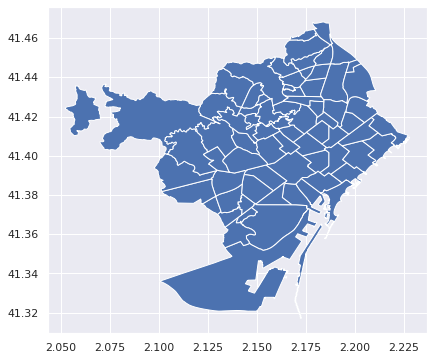

In [60]:
bcn_barrios.plot()

In [61]:
Hosp_clean.head(3)

,CODI_EQUIPAMENT,EQUIPAMENT,SECCIO,TIPUS_VIA,NOM_CARRER,NUM_CARRER_1,NUM_CARRER_2,CODI_BARRI,NUM_BARRI,CODI_DISTRICTE,NOM_DISTRICTE,CODI_POSTAL,LATITUD,LONGITUD,X_ETRS89,Y_ETRS89,X_ED50,Y_ED50
0,68125439,Instituto Oftalmológico Tres Torres,#,Via,Augusta,281,285.0,24,les Tres Torres,5,Sarrià-Sant Gervasi,8017,41.397669,2.129943,427268.090,4583268.854,427359.993,4583469.799
2,179151955,Hospital de dia - Numància,#,C,Numància,9,13.0,18,Sants,3,Sants-Montjuïc,8029,41.381424,2.141052,428178.827,4581456.048,428270.739,4581656.976
4,334115716,Centre d'Atenció Primària Roquetes,#,C,Garigliano,23,27.0,50,les Roquetes,8,Nou Barris,8042,41.446174,2.173934,430996.884,4588617.760,431088.820,4588818.755


## Creamos un GeoDataframe, agregando la columa *'geometry'* 

In [0]:
hospitals_gdf = gpd.GeoDataFrame(Hosp_clean, geometry=gpd.points_from_xy(Hosp_clean.LONGITUD, Hosp_clean.LATITUD))

In [63]:
hospitals_gdf.crs = {'init' :'epsg:4326'}

/usr/local/lib/python3.6/dist-packages/pyproj/crs/crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


In [64]:
# help(folium.Choropleth)

map4 = folium.Map(location=[41.414206, 2.174385], 
                 #tiles='Stamen Toner',
                 zoom_start=12, 
                 control_scale=True)
folium.Choropleth(geo_data=barce,
             data=number_Hosp, # my dataset
             columns=['NUM_BARRI', 'EQUIPAMENT'], # 'NUM_BARRI' es el que hace match con el geojson, Number es la columna que hace que cambie de color
             key_on='feature.properties.NOM', # esto es lo que hce Match con NUM_BARRI (se reviso en el geojson)
             fill_color='YlOrBr', # las opciones de colores que tenemos son : ‘BuGn’, ‘BuPu’, ‘GnBu’, ‘OrRd’, ‘PuBu’, ‘PuBuGn’, ‘PuRd’, ‘RdPu’, ‘YlGn’, ‘YlGnBu’, ‘YlOrBr’, and ‘YlOrRd’.
             nan_fill_color='white',
             highlight=True,   # esto hace que cuando se pasa por enciam se encienda esa parte del mapa
             fill_opacity=0.6, 
             line_opacity=0.2,
             legend_name='Number of Hospitals per NEIGHBORHOOD',
             name='Number of Hospitals per NEIGHBORHOOD',
             smooth_factor=1
             ).add_to(map4)
map4


In [65]:
# help(folium.Icon) para mas información sobre los iconos
# Colores : https://colorbrewer2.org/#type=sequential&scheme=BuGn&n=3

folium.Marker(location=  ,
              popup= ,
              icon=folium.Icon(color='green')
              ).add_to(map4)


SyntaxError: ignored

##  Convertimos al archivo con *'geometry'* en un formato de Geojson con Folium

In [66]:
# Para tener los puntos de los Hospitales debemos tener un archivo con Geometry
# para lo cual convertimos al archivo en un formato de Geojson con Folium
Hosp_points_gjson=folium.features.GeoJson(hospitals_gdf, name='Hospitales')
Hosp_points_gjson

In [67]:
Hosp_points_gjson.to_json('/content/drive/My Drive/Download/TESIS/Output/Hosp_points.json')

'{"name": "GeoJson", "id": "5d69a87ba449412e86b58562487c24be", "children": {}}'

In [0]:
# Hosp_points_gjson.data.get('features')

## Al mapa anterior adicionamos la ubicación de los Hospitales y creamos Layers


In [69]:
map5 = folium.Map(location=[41.414206, 2.174385], 
                 #tiles='Stamen Toner',
                 zoom_start=12, 
                 control_scale=True)

folium.Choropleth(geo_data=barce,
             data=number_Hosp, # my dataset
             columns=['NUM_BARRI', 'EQUIPAMENT'], # 'NUM_BARRI' es el que hace match con el geojson, Number es la columna que hace que cambie de color
             key_on='feature.properties.NOM', # esto es lo que hce Match con NUM_BARRI (se reviso en el geojson)
             fill_color='YlGnBu', # Colores : 'RdYlBu', ‘BuGn’, ‘BuPu’, ‘GnBu’, ‘OrRd’, ‘PuBu’, ‘PuBuGn’, ‘PuRd’, ‘RdPu’, ‘YlGn’, ‘YlGnBu’, ‘YlOrBr’, and ‘YlOrRd’.
             nan_fill_color='white',
             highlight=True,   # esto hace que cuando se pasa por enciam se encienda esa parte del mapa
             fill_opacity=0.6, 
             line_opacity=0.2,
             legend_name='Number of Hospitals per NEIGHBORHOOD',
             name='Number of Hospitals per NEIGHBORHOOD',
             smooth_factor=1
             ).add_to(map5)

Hosp_points_gjson.add_to(map5)

folium.LayerControl().add_to(map5)

map5.save('/content/drive/My Drive/Download/TESIS/Output/hosp.html')

map5

In [0]:
folium.Marker(location=  ,
              popup= ,
              icon=folium.Icon(color='green')
              ).add_to(map5)



In [0]:
'''
folium.features.GeoJson(barce, name='Labels',
                        style_function=lambda x: {'color': 'transparent', 'fillColor': 'transparent', 'weight':0},
                        tooltip=folium.features.GeoJsonTooltip(fields=['NOM'],
                                                               aliases=['NUM_BARRI'],
                                                               labels=True,
                                                               sticky=False)
                        ).add_to(map5)
map5
'''

### Los campos dentro del GeoJson para elegir que aparescan en el Mapa son:

 Choose from: ('AEB', 'ANNEXDESCR', 'AREA', 'AREA_I', 'BARRI', 'CODI_UA', 'COL_DESCR', 'COL_FARCIT', 'CONJ_DESCR', 'DISTRICTE', 'DOCUMENTA', 'ELEM_DESCR', 'ESTIL_ID', 'ESTIL_QGIS', 'FCOL_DESCR', 'FHEX_COLOR', 'GRANBARRI', 'GRUIXDIMEN', 'GRUIX_ID', 'HEX_COLOR7', 'ID_ANNEX', 'ID_CONJUNT', 'ID_ELEMENT', 'ID_SUBCONJ', 'ID_TEMA', 'LITERAL', 'NDESCR_CA', 'NDESCR_EN', 'NDESCR_ES', 'NIVELL', 'NOM', 'ORD_REPRES', 'PERIMETRE', 'RANGESCALA', 'SCONJ_DESC', 'SEC_CENS', 'TEMA_DESCR', 'TERME', 'TIPUS_POL', 'TIPUS_UA', 'VALOR1QGIS', 'VALOR2QGIS', 'WEB1', 'WEB2', 'WEB3', 'ZUA').


In [70]:
map5 = folium.Map(location=[41.414206, 2.174385], 
                 #tiles='Stamen Toner',
                 zoom_start=12, 
                 control_scale=True)

folium.Choropleth(geo_data=barce,
             data=number_Hosp, # my dataset
             columns=['NUM_BARRI', 'EQUIPAMENT'], # 'NUM_BARRI' es el que hace match con el geojson, Number es la columna que hace que cambie de color
             key_on='feature.properties.NOM', # esto es lo que hce Match con NUM_BARRI (se reviso en el geojson)
             fill_color='YlGnBu', # Colores : 'RdYlBu', ‘BuGn’, ‘BuPu’, ‘GnBu’, ‘OrRd’, ‘PuBu’, ‘PuBuGn’, ‘PuRd’, ‘RdPu’, ‘YlGn’, ‘YlGnBu’, ‘YlOrBr’, and ‘YlOrRd’.
             nan_fill_color='white',
             highlight=True,   # esto hace que cuando se pasa por enciam se encienda esa parte del mapa
             fill_opacity=0.6, 
             line_opacity=0.2,
             legend_name='Number of Hospitals per NEIGHBORHOOD',
             name='Number of Hospitals per NEIGHBORHOOD',
             smooth_factor=1
             ).add_to(map5)

Hosp_points_gjson.add_to(map5)

folium.features.GeoJson(barce, name='Name of Neightborhood',
                        style_function=lambda x: {'color': 'transparent', 'fillColor': 'transparent', 'weight':1},
                        tooltip=folium.features.GeoJsonTooltip(fields=['NOM'], # esta informacion se obtiene del Dataset de de los poligonos de Barcelona
                                                               aliases= ['Neightborhood:'], # cambiando a False ya no aparece el Alias delante del nombre
                                                               labels=True,
                                                               sticky=False)
                        ).add_to(map5)

folium.LayerControl().add_to(map5)

map5.save('/content/drive/My Drive/Download/TESIS/Output/hosp5.html')

map5

In [71]:
map6 = folium.Map(location=[41.414206, 2.174385], 
                 #tiles='Stamen Toner',
                 zoom_start=12, 
                 control_scale=True)

folium.Choropleth(geo_data=barce,
             data=number_Hosp, # my dataset
             columns=['NUM_BARRI', 'EQUIPAMENT'], # 'NUM_BARRI' es el que hace match con el geojson, Number es la columna que hace que cambie de color
             key_on='feature.properties.NOM', # esto es lo que hce Match con NUM_BARRI (se reviso en el geojson)
             fill_color='YlGnBu', # Colores : 'RdYlBu', ‘BuGn’, ‘BuPu’, ‘GnBu’, ‘OrRd’, ‘PuBu’, ‘PuBuGn’, ‘PuRd’, ‘RdPu’, ‘YlGn’, ‘YlGnBu’, ‘YlOrBr’, and ‘YlOrRd’.
             nan_fill_color='white',
             highlight=True,   # esto hace que cuando se pasa por enciam se encienda esa parte del mapa
             fill_opacity=0.6, 
             line_opacity=0.2,
             legend_name='Number of Hospitals per NEIGHBORHOOD',
             name='Number of Hospitals per NEIGHBORHOOD',
             smooth_factor=1
             ).add_to(map6)

Hosp_points_gjson.add_to(map6)

folium.features.GeoJson(barce, name='Name of Neightborhood',
                        style_function=lambda x: {'color': 'transparent', 'fillColor': 'transparent', 'weight':1},
                        tooltip=folium.features.GeoJsonTooltip(fields=['NOM','WEB1'],
                                                               aliases= ['Neightborhood:', 'Web Page:'],
                                                               labels=True,
                                                               sticky=False)
                        ).add_to(map6)
'''
folium.features.GeoJson(barce, name='Web of Neightborhood',
                        style_function=lambda x: {'color': 'transparent', 'fillColor': 'transparent', 'weight':1},
                        tooltip=folium.features.GeoJsonTooltip(fields=['WEB1'],
                                                               labels=False,
                                                               sticky=False)
                        ).add_to(map6)
'''

folium.LayerControl().add_to(map6)

map6.save('/content/drive/My Drive/Download/TESIS/Output/hosp6.html')

map6

In [72]:
map8 = folium.Map(location=[41.414206, 2.174385], 
                 #tiles='Stamen Toner',
                 zoom_start=12, 
                 control_scale=True)

marker_cluster= MarkerCluster(name='Clusters').add_to(map8)

folium.Choropleth(geo_data=barce,
             data=number_Hosp, # my dataset
             columns=['NUM_BARRI', 'EQUIPAMENT'], # 'NUM_BARRI' es el que hace match con el geojson, Number es la columna que hace que cambie de color
             key_on='feature.properties.NOM', # esto es lo que hce Match con NUM_BARRI (se reviso en el geojson)
             fill_color='YlGnBu', # Colores : 'RdYlBu', ‘BuGn’, ‘BuPu’, ‘GnBu’, ‘OrRd’, ‘PuBu’, ‘PuBuGn’, ‘PuRd’, ‘RdPu’, ‘YlGn’, ‘YlGnBu’, ‘YlOrBr’, and ‘YlOrRd’.
             nan_fill_color='white',
             highlight=True,   # esto hace que cuando se pasa por enciam se encienda esa parte del mapa
             fill_opacity=0.6, 
             line_opacity=0.2,
             legend_name='Number of Hospitals per NEIGHBORHOOD',
             name='Number of Hospitals per NEIGHBORHOOD',
             smooth_factor=1
             ).add_to(map8)

for idx, row in Hosp_clean.iterrows():
  lon= row['LONGITUD']
  lat= row['LATITUD']
  popup_text=row['EQUIPAMENT']
  coords = (lat,lon)

  folium.Marker(location=[lat,lon],
                popup=popup_text,
                icon=folium.Icon(icon='medkit',prefix="fa")
                ).add_to(marker_cluster)

#Hosp_points_gjson.add_to(map8)

folium.features.GeoJson(barce, name='Name of Neightborhood',
                        style_function=lambda x: {'color': 'transparent', 'fillColor': 'transparent', 'weight':1},
                        tooltip=folium.features.GeoJsonTooltip(fields=['NOM','WEB1'],
                                                               aliases= ['Neightborhood:', 'Web Page:'],
                                                               labels=True,
                                                               sticky=False)
                        ).add_to(map8)


folium.LayerControl().add_to(map8)

map8.save('/content/drive/My Drive/Download/TESIS/Output/hosp8.html')

map8

In [74]:
map9 = folium.Map(location=[41.414206, 2.174385], 
                 #tiles='Stamen Toner',
                 zoom_start=12, 
                 control_scale=True)

marker_cluster= MarkerCluster(name='Clusters').add_to(map9)

folium.Choropleth(geo_data=barce,
             data=number_Hosp, # my dataset
             columns=['NUM_BARRI', 'EQUIPAMENT'], # 'NUM_BARRI' es el que hace match con el geojson, Number es la columna que hace que cambie de color
             key_on='feature.properties.NOM', # esto es lo que hce Match con NUM_BARRI (se reviso en el geojson)
             fill_color='YlGnBu', # Colores : 'RdYlBu', ‘BuGn’, ‘BuPu’, ‘GnBu’, ‘OrRd’, ‘PuBu’, ‘PuBuGn’, ‘PuRd’, ‘RdPu’, ‘YlGn’, ‘YlGnBu’, ‘YlOrBr’, and ‘YlOrRd’.
             nan_fill_color='white',
             highlight=True,   # esto hace que cuando se pasa por enciam se encienda esa parte del mapa
             fill_opacity=0.6, 
             line_opacity=0.2,
             legend_name='Number of Hospitals per NEIGHBORHOOD',
             name='Number of Hospitals per NEIGHBORHOOD',
             smooth_factor=1
             ).add_to(map9)

for idx, row in Hosp_clean.iterrows():
  lon= row['LONGITUD']
  lat= row['LATITUD']
  popup_text=row['EQUIPAMENT']
  coords = (lat,lon)

  folium.Marker(location=[lat,lon],
                popup=popup_text,
                icon=folium.Icon(icon='medkit',prefix="fa")
                ).add_to(marker_cluster)

#Hosp_points_gjson.add_to(map8)

folium.features.GeoJson(barce, name='Name of Neightborhood',
                        style_function=lambda x: {'color': 'transparent', 'fillColor': 'transparent', 'weight':1},
                        tooltip=folium.features.GeoJsonTooltip(fields=['NOM','WEB1'],
                                                               aliases= ['Neightborhood:', 'Web Page:'],
                                                               labels=True,
                                                               sticky=False)
                        ).add_to(map9)


folium.LayerControl().add_to(map8)

map9.save('/content/drive/My Drive/Download/TESIS/Output/hosp8.html')

map9

## Ejemplo de Cluster

Necesitamos utilizar el archivo que convertimos a GeoJson con Folium


In [0]:
marker_Cluster = MarkerCluster(locations=Hosp_points_gjson
                               )

Si queremos hacer un mapa simple con una libtrería adicional de Matplotlib

In [0]:
import mplleaflet

In [0]:
ax=hospitals_gdf.plot(markersize=50, color='green')
mplleaflet.display(fig=ax.figure)

In [0]:
Hosp_clean.columns

In [0]:
map7 = folium.Map(location=[41.414206, 2.174385], 
                 #tiles='Stamen Toner',
                 zoom_start=12, 
                 control_scale=True)
for idx, row in Hosp_clean.iterrows():
  lon= row['LONGITUD']
  lat= row['LATITUD']
  popup_text=row['EQUIPAMENT']
  coords = (lat,lon)

  folium.Marker(location=[lat,lon],
                popup=popup_text,
                icon=folium.Icon(icon='medkit',prefix="fa")
                ).add_to(map7)
map7

In [0]:
help(folium.Icon)

## Referencias

https://www.drawingfromdata.com/how-to-rotate-axis-labels-in-seaborn-and-matplotlib

https://nbviewer.jupyter.org/github/python-visualization/folium/blob/master/examples/GeoJSON_and_choropleth.ipynb

https://towardsdatascience.com/using-folium-to-generate-choropleth-map-with-customised-tooltips-12e4cec42af2

Comuna Santiago :
https://towardsdatascience.com/mapping-geograph-data-in-python-610a963d2d7f

España Cholopleth maps: https://towardsdatascience.com/choropleth-maps-with-folium-1a5b8bcdd392

Interactivos : https://nbviewer.jupyter.org/github/python-visualization/folium_contrib/blob/master/notebooks/HereMapsApiExplorer_no_creds.ipynb

Crear Clsuters : https://medium.com/@saidakbarp/interactive-map-visualization-with-folium-in-python-2e95544d8d9b

Folium Course :   https://www.youtube.com/watch?v=V0ovj5F-Y3M

GeoJson. :  https://geoffboeing.com/2015/10/exporting-python-data-geojson/

https://books.google.es/books?id=PUPsCQAAQBAJ&pg=PA25&lpg=PA25&dq=save+geojson+python&source=bl&ots=IKnegLF2tn&sig=ACfU3U2hGq2vA9WeF1FzNZ4YcH9fPj9lzw&hl=es-419&sa=X&ved=2ahUKEwjnzpORlNHpAhWGlxQKHdKEC58Q6AEwB3oECAoQAQ#v=onepage&q=save%20geojson%20python&f=false
